# **CBB Statistics**
### Final Project Notebook

*Authors: Reagan Burkemper, Jacob Tyree, Ben Nguyen*

##  **Research Question**
- Can NCAA Division I Men’s Basketball team's regular-season statistics predict their postseason tournament success when grouped into four performance groups: "No Appearance", "Tournament Appearance", "Runner Up", and "Champion Possible"?

## **Hypothesis:**
- *Null Hypothesis:* Tournament grouping into "No Appearance", "Tournament Appearance", "Runner Up", and "Champion Possible" is not predictable from season statistics.
- *Alternative Hypothesis:* Tournament grouping into "No Appearance", "Tournament Appearance", "Runner Up", and "Champion Possible" is predictable from season statistics.

## **Imports**

In [1]:
#imports
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder
from scipy.stats import shapiro, kruskal, chi2_contingency
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.tree import DecisionTreeClassifier, plot_tree
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import learning_curve, validation_curve
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

## **Dataset** 

The data set was created by Andrew Sundberg, which contains data from 2013 to 2025 for every college basketball team. This data set was created for data scientists and analysts to predict tournament successes by looking at team statistics. Typically, the target variable would be postseason or seed, because they could be used to see how well the team does in the NCAA tournament. However, we are clustering and will only look at the feature variables."

In [2]:
#load and display the first 5 rows of the dataset using pandas
basketball_df = pd.read_csv('cbb.csv')
basketball_df.head()

,TEAM,CONF,G,W,ADJOE,ADJDE,BARTHAG,EFG_O,EFG_D,TOR,...,FTRD,2P_O,2P_D,3P_O,3P_D,ADJ_T,WAB,POSTSEASON,SEED,YEAR
0,North Carolina,ACC,40,33,123.3,94.9,0.9531,52.6,48.1,15.4,...,30.4,53.9,44.6,32.7,36.2,71.7,8.6,2ND,1.0,2016
1,Wisconsin,B10,40,36,129.1,93.6,0.9758,54.8,47.7,12.4,...,22.4,54.8,44.7,36.5,37.5,59.3,11.3,2ND,1.0,2015
2,Michigan,B10,40,33,114.4,90.4,0.9375,53.9,47.7,14.0,...,30.0,54.7,46.8,35.2,33.2,65.9,6.9,2ND,3.0,2018
3,Texas Tech,B12,38,31,115.2,85.2,0.9696,53.5,43.0,17.7,...,36.6,52.8,41.9,36.5,29.7,67.5,7.0,2ND,3.0,2019
4,Gonzaga,WCC,39,37,117.8,86.3,0.9728,56.6,41.1,16.2,...,26.9,56.3,40.0,38.2,29.0,71.5,7.7,2ND,1.0,2017


In [3]:
basketball_df.describe()

,G,W,ADJOE,ADJDE,BARTHAG,EFG_O,EFG_D,TOR,TORD,ORB,...,FTR,FTRD,2P_O,2P_D,3P_O,3P_D,ADJ_T,WAB,SEED,YEAR
count,3523.000000,3523.000000,3523.000000,3523.000000,3523.000000,3523.000000,3523.000000,3523.000000,3523.000000,3523.000000,...,3523.000000,3523.000000,3523.000000,3523.000000,3523.000000,3523.000000,3523.000000,3523.000000,680.000000,3523.000000
mean,30.486233,15.990633,103.151320,103.153250,0.494067,49.887823,50.087113,18.696509,18.625092,29.308544,...,34.529066,34.802555,49.112433,49.289299,34.185580,34.369316,67.735339,-7.579620,8.801471,2017.828555
std,3.951584,6.572893,7.264859,6.511989,0.255338,3.078505,2.894967,2.104119,2.241067,4.214131,...,5.514264,6.396757,3.400389,3.317012,2.729186,2.435546,3.091703,6.815976,4.673461,3.257824
min,5.000000,0.000000,76.600000,84.000000,0.005000,39.200000,39.600000,11.900000,10.200000,14.400000,...,19.600000,16.500000,37.700000,37.700000,24.900000,26.100000,57.200000,-25.200000,1.000000,2013.000000
25%,29.000000,11.000000,98.200000,98.400000,0.281300,47.900000,48.100000,17.300000,17.100000,26.500000,...,30.600000,30.200000,46.800000,47.100000,32.300000,32.700000,65.700000,-12.600000,5.000000,2015.000000
50%,31.000000,16.000000,102.800000,103.200000,0.475600,49.800000,50.100000,18.600000,18.500000,29.400000,...,34.300000,34.100000,49.000000,49.300000,34.100000,34.300000,67.700000,-7.900000,9.000000,2018.000000
75%,33.000000,21.000000,107.900000,107.800000,0.714250,51.900000,52.000000,20.000000,20.100000,32.100000,...,38.100000,38.800000,51.300000,51.500000,36.000000,36.000000,69.700000,-3.000000,13.000000,2021.000000
max,40.000000,38.000000,129.100000,124.000000,0.984200,61.000000,60.100000,27.100000,28.500000,43.600000,...,58.600000,60.700000,64.000000,61.200000,44.100000,43.100000,83.400000,13.100000,16.000000,2023.000000


**Categorizing the variables into numerical and categorical**

In [4]:
numerical_vars = ["G", "W", "ADJOE", "ADJDE", "BARTHAG", "EFG_O", "EFG_D", "TOR", "TORD", 
                  "ORB", "DRB", "FTR", "FTRD", "2P_O", "2P_D", "3P_O", "3P_D", "ADJ_T", "WAB"]
categorical_vars = ["CONF", "POSTSEASON", "SEED", "YEAR"]

## **Data Preprocessing**

In this section:
- Check for missing values
- Group mapping
- Explaination for not scaling numerical variables 

### **Missing Values Check** 

Both the Seed and Postseason columns are missing the same amount of values that make up 80.7% of there entires. The missing values occur because the majority of teams don't make the NCAA Tournament. Since only qualifying teams are assigned a tournament seed and have postseason results, the absence of data in these columns is intentional and meaningful. Therefore, for this case, these are no truly "missing" values. For the analysis, these values were replaces with "No Tournament" in Postseason and "None" in Seed.

In [5]:
#Check for missing values
missing_counts = basketball_df.isnull().sum()
missing_percent = (missing_counts / len(basketball_df)) * 100
missing_values = pd.DataFrame({
    'Missing Count': missing_counts, 
    '% Missing': missing_percent
    })
missing_values.head(len(missing_values))

,Missing Count,% Missing
TEAM,0,0.000000
CONF,0,0.000000
G,0,0.000000
W,0,0.000000
ADJOE,0,0.000000
ADJDE,0,0.000000
BARTHAG,0,0.000000
EFG_O,0,0.000000
EFG_D,0,0.000000
TOR,0,0.000000


In [6]:
#replace missing values
basketball_df['SEED'] = basketball_df['SEED'].fillna("None")
basketball_df['POSTSEASON'] = basketball_df['POSTSEASON'].fillna("No Tournament")
basketball_df.head()

,TEAM,CONF,G,W,ADJOE,ADJDE,BARTHAG,EFG_O,EFG_D,TOR,...,FTRD,2P_O,2P_D,3P_O,3P_D,ADJ_T,WAB,POSTSEASON,SEED,YEAR
0,North Carolina,ACC,40,33,123.3,94.9,0.9531,52.6,48.1,15.4,...,30.4,53.9,44.6,32.7,36.2,71.7,8.6,2ND,1.0,2016
1,Wisconsin,B10,40,36,129.1,93.6,0.9758,54.8,47.7,12.4,...,22.4,54.8,44.7,36.5,37.5,59.3,11.3,2ND,1.0,2015
2,Michigan,B10,40,33,114.4,90.4,0.9375,53.9,47.7,14.0,...,30.0,54.7,46.8,35.2,33.2,65.9,6.9,2ND,3.0,2018
3,Texas Tech,B12,38,31,115.2,85.2,0.9696,53.5,43.0,17.7,...,36.6,52.8,41.9,36.5,29.7,67.5,7.0,2ND,3.0,2019
4,Gonzaga,WCC,39,37,117.8,86.3,0.9728,56.6,41.1,16.2,...,26.9,56.3,40.0,38.2,29.0,71.5,7.7,2ND,1.0,2017


### **Group Mapping**
**POSTSEASON labels were encoded numerically for compatibility with classification models** 

A new column labeled "Tournament Grouping" was added to the dataset to categorize each team’s level of success in the postseason tournament. The LabelEncoder was used to convert these categories into numeric labels for classification models.

The groups are an ordinal variable because represent a progression of tournament success (No Appearance then Tournament Appearance then Runner Up then Champion Possible). Tree-based models use these label-encoded integers to create logical splits, without assuming a linear relationship between the categories.

In [7]:
group_mapping = {
    'Champions': 'Champion Possible',
    '2ND': 'Champion Possible',
    'F4': 'Champion Possible',
    'S16': 'Runner Up',
    'E8': 'Runner Up',
    'R64': 'Tournament Appearance',
    'R32': 'Tournament Appearance',
    'R68': 'Tournament Appearance',
}

basketball_df['Tournament Grouping'] = basketball_df['POSTSEASON'].map(group_mapping).fillna('No Appearance')
print(basketball_df['Tournament Grouping'].value_counts())
basketball_df.head()

Tournament Grouping
No Appearance            2843
Tournament Appearance     520
Runner Up                 120
Champion Possible          40
Name: count, dtype: int64


,TEAM,CONF,G,W,ADJOE,ADJDE,BARTHAG,EFG_O,EFG_D,TOR,...,2P_O,2P_D,3P_O,3P_D,ADJ_T,WAB,POSTSEASON,SEED,YEAR,Tournament Grouping
0,North Carolina,ACC,40,33,123.3,94.9,0.9531,52.6,48.1,15.4,...,53.9,44.6,32.7,36.2,71.7,8.6,2ND,1.0,2016,Champion Possible
1,Wisconsin,B10,40,36,129.1,93.6,0.9758,54.8,47.7,12.4,...,54.8,44.7,36.5,37.5,59.3,11.3,2ND,1.0,2015,Champion Possible
2,Michigan,B10,40,33,114.4,90.4,0.9375,53.9,47.7,14.0,...,54.7,46.8,35.2,33.2,65.9,6.9,2ND,3.0,2018,Champion Possible
3,Texas Tech,B12,38,31,115.2,85.2,0.9696,53.5,43.0,17.7,...,52.8,41.9,36.5,29.7,67.5,7.0,2ND,3.0,2019,Champion Possible
4,Gonzaga,WCC,39,37,117.8,86.3,0.9728,56.6,41.1,16.2,...,56.3,40.0,38.2,29.0,71.5,7.7,2ND,1.0,2017,Champion Possible


### **No Scaling**
We are not scaling our data through normalization. This is necessary for distance-based algorithms, whereas we use the Random Forest and Decision Tree algorithms, which are tree-based models. Tree-based algorithms are insensitive to feature scaling. Each node in a Random Forest does not compare feature values. It does not warrant normalization because it splits a sorted list that needs absolute values for branching. The algorithm is based on partitioning the data to make predictions. A decision tree splits a node on a feature, where another feature does not influence this feature and neither does it influence another feature. This means that all the remaining features do not affect the split. 

## **Data analysis and visualization** 


Statistical tests are ran before training the machine learning models. The Kruskal-Wallis Test is ran for numerical features and the Chi-Square Test for categorical features. The test show statistically significant features that differentiate the tournament groups. This is meant to help reduce noise and avoid overfitting.

##### **Pair Plot & Heat Map**

A pair plot is an exploratory data analysis tool used to visually assess how the input features relate to each other and to the target variable (Tournament Grouping). It shows feature correlations which helped find redundant features. ADJOE and BARTHAG form a near perfect diagonal line, so they are likely redundant. The correlation heatmap shows linear relationships between all numerical features. It also helped find redundant features. BARTHAG and WAB had r = 0.93. Both measure team strength;

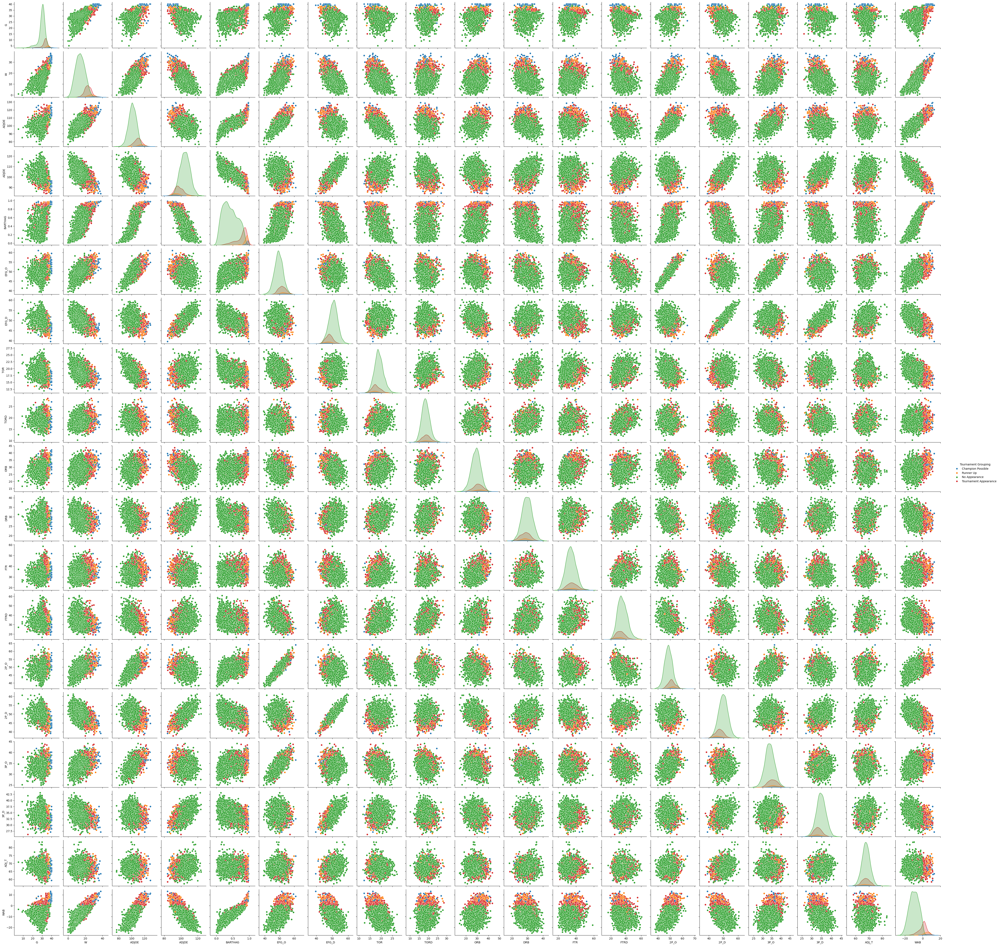

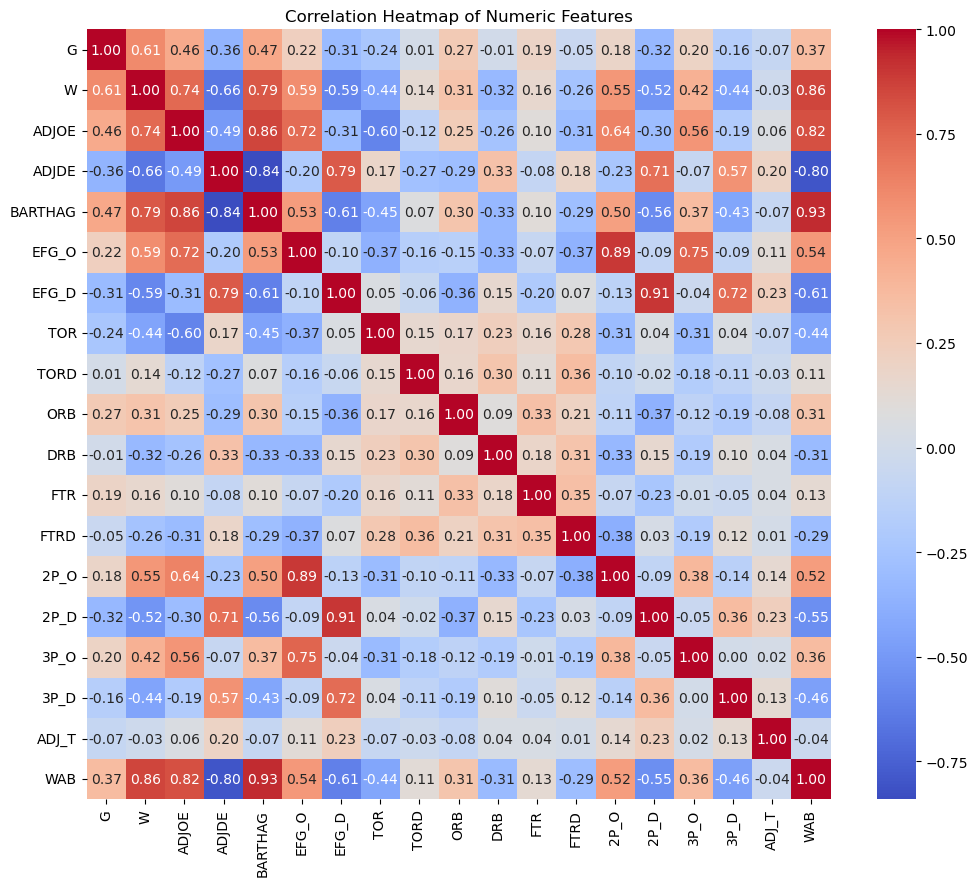

In [8]:
#visualization
# Focus on top 5-6 most important features (from correlation/statistical tests)
key_vars = ['WAB', 'W', 'BARTHAG', 'ADJOE', 'ADJDE', 'G', 'EFG_O']
sns.pairplot(data = basketball_df, hue= 'Tournament Grouping', vars=basketball_df[numerical_vars])#    plot_kws={'alpha': 0.6}  # Reduce overplotting
plt.show()

# #correlation heatmap
plt.figure(figsize=(12, 10))
cor = basketball_df[numerical_vars].corr()
sns.heatmap(cor, annot=True, fmt='.2f', cmap='coolwarm')
plt.title('Correlation Heatmap of Numeric Features')
plt.show()

##### **Shapiro-Wilk Test** 

Testing for normal distribution

The Shapiro-Wilk test is used to determine whether the dataset is normally distributed. This is run before choosing a statistical method because some assume normality. 

The test returns the test statistic and the p-value. The test statistic measures how close the sample is to a normal distribution. The closer the test statistic is to 1, the more normal the feature is. The p-value indicates if it is statistically significant. However, even if the test statistics are close to 1, it can still not be normal if the p-value is too small because in that case, a tiny deviation is statistically significant. 

Shapiro-Wilk Test:  

If p-value > 0.05, the data is normally distributed. 

If p-value ≤ 0.05, the data is not normally distributed.

The results of this test showed that the data is not normally distributed. From this, non-parametric tests were chosen: Kruskal-Wallis (for numerical), Chi-Square (for categorical)

In [9]:
#Normality test using Shapiro-Wilk test
shapiro_results = {}
for var in numerical_vars:
    stat, p = shapiro( basketball_df[numerical_vars][var])
    shapiro_results[var] = {
        'Test Statistic': stat,
        'p-value': p,
        'Is Normal': p > 0.05
    }
shapiro_df = pd.DataFrame(shapiro_results).T.sort_values('p-value')
shapiro_df.head(len(shapiro_df))

,Test Statistic,p-value,Is Normal
G,0.91468,0.0,False
BARTHAG,0.958721,0.0,False
FTRD,0.985712,0.0,False
W,0.990524,0.0,False
WAB,0.991769,0.0,False
TORD,0.992044,0.0,False
FTR,0.99519,0.0,False
TOR,0.995449,0.0,False
ADJ_T,0.995644,0.0,False
ADJOE,0.997174,0.000004,False


##### **Kruskal Wallace Test**

The Kruskal-Wallis test determines whether there are statistically significant differences in the distributions of numerical features across the tournament groupings. It is a non-parametric alternative to ANOVA and we chose Kruskal-Wallis since the data violates normality assumptions (confirmed by Shapiro-Wilk tests).

**Method**
- Tested all numerical variables against `Tournament Grouping` groups
- Applied Bonferroni correction for multiple comparisons (p = 0.05/n_features)
- Features with p-value < adjusted p-value were considered significant

1. **Most Significant Features** (p =~ 0):
   - `WAB` (Wins Above Bubble): Most significant (p=4.89e-278)
   - `W` (Wins): p=6.14e-253
   - `BARTHAG` (Team Strength): p=4.93e-249
   - Offensive/Defensive metrics (`ADJOE`, `ADJDE`) also highly significant

2. **Non-Significant Feature**:
   - `ADJ_T` (Adjusted Tempo): p=0.235, dropped from numerical variables

The results prove that teams season statistics strongly differentiate postseason success levels, supporting our hypothesis that regular season statistics predict tournament outcomes.

In [10]:
kruskal_results = []

for var in numerical_vars:
    samples_by_group = []
    for value in set(basketball_df['Tournament Grouping']):
        mask = basketball_df['Tournament Grouping'] == value
        samples_by_group.append(basketball_df[var][mask])
    
    stat, p_value = kruskal(*samples_by_group)
    
    kruskal_results_dict = {
        'Variable': var,
        'Test Statistic': stat,
        'p-value': p_value,
        'Significant': p_value < (0.05 / len(numerical_vars))  #bonferroni correction
    }
    
    kruskal_results.append(kruskal_results_dict)

kruskal_df = pd.DataFrame(kruskal_results).sort_values('p-value')
kruskal_df.head(len(kruskal_df))


,Variable,Test Statistic,p-value,Significant
18,WAB,1283.805242,4.805752e-278,True
1,W,1183.300523,3.079005e-256,True
4,BARTHAG,1135.320692,7.909073e-246,True
2,ADJOE,958.968869,1.431695e-207,True
3,ADJDE,852.838924,1.500592e-184,True
0,G,655.028933,1.183059e-141,True
6,EFG_D,561.073596,2.764641e-121,True
14,2P_D,436.342351,2.966935e-94,True
5,EFG_O,433.172643,1.442200e-93,True
13,2P_O,377.734843,1.470956e-81,True


##### **Chi-Square Test**
The Chi-Square test evaluates whether categorical features are associated with tournament groupings. This was used to find which categorical variables could be included in the predictive models.

**Method**
- Tested categorical variables: `CONF`, `SEED`, `YEAR`
- Used Bonferroni correction (p = 0.05/n_categories)
- Significant association if p-value < adjusted p-value

1. **Strongly Associated Features**:
   - `SEED`: Extremely significant (p≈0) - Tournament seeding strongly relates to postseason performance
   - `CONF`: p=1.47e-79 - Conference affiliation impacts postseason success

2. **Non-Significant Feature**:
   - `YEAR`: p=1.0, removed from categorical variables

Conference affiliation and tournament seeding are meaningfully associated with tournament groupings, whereas Year did not so it was removed.

In [11]:
#categorical variable and POSTSEASON
chi2_results = []
for var in categorical_vars:
    combo_counts = pd.crosstab(basketball_df[var], basketball_df['Tournament Grouping'])
    chi2, p, _, _ = chi2_contingency(combo_counts)
    chi2_results_dict ={
        'Variable': var,
        'Chi2 Statistic': chi2,
        'p-value': p,
        'Significant': p < (0.05 / len(categorical_vars))  #bonferroni correction
    }
    chi2_results.append(chi2_results_dict)

chi2_df = pd.DataFrame(chi2_results).sort_values('p-value')
chi2_df.head(len(chi2_df))

,Variable,Chi2 Statistic,p-value,Significant
1,POSTSEASON,10569.000000,0.000000e+00,True
2,SEED,4762.231181,0.000000e+00,True
0,CONF,722.325534,4.126385e-94,True
3,YEAR,0.141960,1.000000e+00,False


#### **Final Feature Selection**

Removed features that are not statistically significant or redundant. 

**Removed Features** 
- `ADJ_T`: labed not significant from Kruskal-Wallis p=0.211
- `BARTHAG`: redundant with WAB from heatmap correlation=0.93 

In [12]:
important_numerical_features = ['G', 'W', 'ADJOE', 'ADJDE', 'EFG_O', 'EFG_D', 'TOR', 'TORD', 'ORB', 'DRB', 'FTR', 'FTRD', '2P_O', '2P_D', '3P_O', '3P_D', 'WAB']

## **Data modeling and prediction** 

In this section, different classification models were created to predict a team's postseason performance group based on regular-season statistics. 
- Train/Test Split: The data was split into 70% training and 30% testing using stratified sampling to preserve class distribution
- Model 1 Baseline Random Forest: No hyperparameters, it achieved high accuracy but was overfit (100% train vs. ~90% test)
- Model 2 Tuned Random Forest: Used GridSearchCV to find the best max_depth
- Model 3 SMOTE & Random Forest: SMOTE was used to oversample minority classes, and a shallower tree was used. This reduced overfitting and improved the performance of underrepresented groups.
- Model 4 Decision Tree: Tested different max_depth values using validation_curve, then trained a tree with depth 4. Had a slightly lower performance.

Each model's performance was evaluated using accuracy, cross-validation scores, classification reports, and confusion matrices. Learning curves were also included to visualize overfitting and training behavior. We used the macro f1 score and looked at the confusion matrices to find the model that did well with predicting all groupings. 

In [34]:
#Used *LabelEncoder()* to encode target variable `Tournament Grouping` into numerical labels
label_encoder = LabelEncoder()
basketball_df['GROUP_LABEL'] = label_encoder.fit_transform(basketball_df['Tournament Grouping'])

#Split data into features `X` and target `y`
y = basketball_df['GROUP_LABEL']
X = basketball_df[important_numerical_features]

#Stratified train-test split (70-30) to maintain class distribution
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=42, stratify=y
)

### **Baseline Random Forest**

A baseline Random Forest model was trained using its default hyperparameters. Model 1 established a performance benchmark, achieving 100% training accuracy and ~90% test accuracy. Accuracy is misleading as the model was very overfit, and while it provided strong performance on the majority class ("No Appearance"), it struggled with minority classes like "Runner Up" and "Champion Possible". 

Training Accuracy: 1.0
Test Accuracy: 0.9006622516556292
Classification Report:
                       precision    recall  f1-score   support

    Champion Possible       0.75      0.50      0.60        12
        No Appearance       0.93      0.98      0.96       853
            Runner Up       0.55      0.31      0.39        36
Tournament Appearance       0.75      0.61      0.67       156

             accuracy                           0.90      1057
            macro avg       0.74      0.60      0.66      1057
         weighted avg       0.89      0.90      0.89      1057



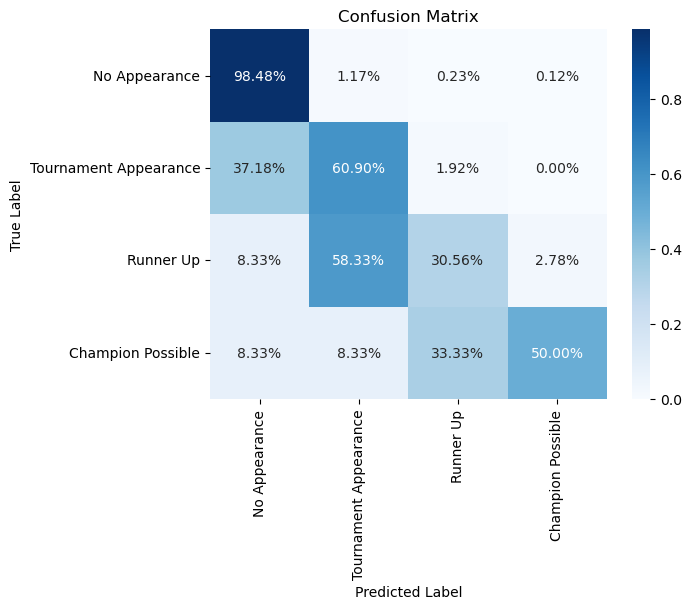

In [35]:
#Initialize Random Forest with class weighting to handle imbalance
rf = RandomForestClassifier(random_state=42)
rf.fit(X_train, y_train)

#Predictions and accuracy scores
y_pred = rf.predict(X_test)
test_accuracy = rf.score(X_test, y_test)
train_accuracy = rf.score(X_train, y_train) #check for overfitting

#Print accuracy results
print("Training Accuracy:", train_accuracy)
print("Test Accuracy:", test_accuracy)

#Print Classification Report
report = classification_report(y_test, y_pred, target_names=label_encoder.classes_)
print("Classification Report:")
print(report)

#Custom order for confusion matrix labels for better visualization
custom_order = ['No Appearance', 'Tournament Appearance', 'Runner Up', 'Champion Possible']
cm = confusion_matrix(y_test, y_pred, labels=[label_encoder.transform([label])[0] for label in custom_order])

#Normalize the confusion matrix so that each value represents a percentage instead of the count of predictions
cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

#Plot the heatmap
sns.heatmap(cm_normalized, annot=True, fmt='.2%', cmap='Blues', xticklabels=custom_order, yticklabels=custom_order)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()


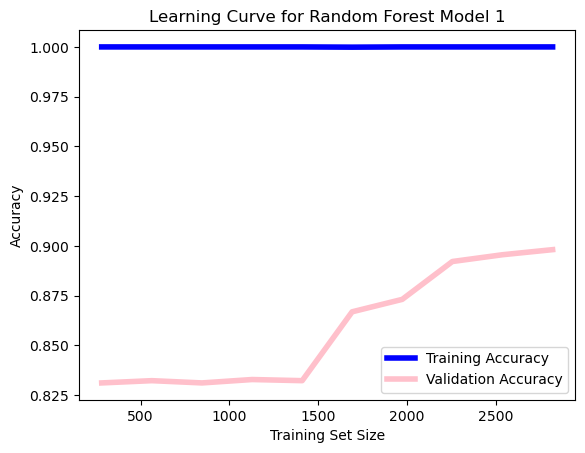

In [36]:
#Learning curve data
train_sizes, train_scores, test_scores = learning_curve(
    rf, X, y, cv=5, scoring='accuracy', train_sizes=np.linspace(0.1, 1.0, 10), random_state=42
)

#Calculate mean for training and testing scores
train_mean = np.mean(train_scores, axis=1)
test_mean = np.mean(test_scores, axis=1)

# lot the learning curve
plt.plot(train_sizes, train_mean, label='Training Accuracy', color='blue')
plt.plot(train_sizes, test_mean, label='Validation Accuracy', color='pink')
plt.title('Learning Curve for Random Forest Model 1')
#make the line thicker for presentation
plt.gca().get_lines()[0].set_linewidth(4)
plt.gca().get_lines()[1].set_linewidth(4)
plt.xlabel('Training Set Size')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

**Results** 

The baseline model achieved perfect training accuracy (100%), but looking at the learning curve the validation accuracy plateaued at ~90%. This shows overfitting, where the model memorizes the training data and does not do well with new data.

Class Performance:
- Best: `No Appearance` (F1=96%), had a high recall (98%) which means few false negatives
- Worst: `Runner Up` (F1=37%), had a low recall (25%) which means it was difficult to predict

Confusion Matrix Insights:
- `Champion Possible` teams: 58.3% correctly predicted, 25% misclassified as `Runner Up`
- `Tournament Appearance` teams: 60.3% correctly predicted, 37.8% misclassified as `No Appearance`

Even though test accuracy is high (~90%), the confusion matrix shows the class imbalance, with the model being biased toward dominant categories.

### **Model 2 Tuned Random Forest**

Model 2 builds on the baseline model by including hyperparameter tuning. We used GridSearchCV to find specificaly optimize the max_depth parameter to reduce overfitting. 

**Hyperparameter Tuning with GridSearchCV** 

GridSearchCV systematically searches for the best combination of hyperparameters. Here is was tested specifically to find the ideal max_depth: Controls tree complexity (prevent overfitting).

In [16]:
param_grid = {
    'max_depth': [4, 5, 6, 7, 8, 9, 10, None],  ##test tree depth limits, note: unlimited depth (None)
    'n_estimators': [100] , #fixed number of trees
    'class_weight': ['balanced'] #for class imbalance
}
rf = RandomForestClassifier(random_state=42)

#grid search with 5-fold cross-validation
grid_search = GridSearchCV(rf, param_grid, cv=5, scoring='accuracy', n_jobs=-1)
grid_search.fit(X_train, y_train)

print("Best Parameters:", grid_search.best_params_)
print("Best Cross-Validation Accuracy:", grid_search.best_score_)

Best Parameters: {'class_weight': 'balanced', 'max_depth': None, 'n_estimators': 100}
Best Cross-Validation Accuracy: 0.8974098923388985


Training Accuracy: 1.0
Test Accuracy: 0.8968779564806055
Cross-Validation Accuracy (mean): 0.8974098923388985
Cross-Validation Accuracy (std): 0.008496721237108065
Classification Report:
                       precision    recall  f1-score   support

    Champion Possible       0.78      0.58      0.67        12
        No Appearance       0.93      0.98      0.96       853
            Runner Up       0.58      0.19      0.29        36
Tournament Appearance       0.70      0.62      0.66       156

             accuracy                           0.90      1057
            macro avg       0.75      0.60      0.64      1057
         weighted avg       0.88      0.90      0.89      1057



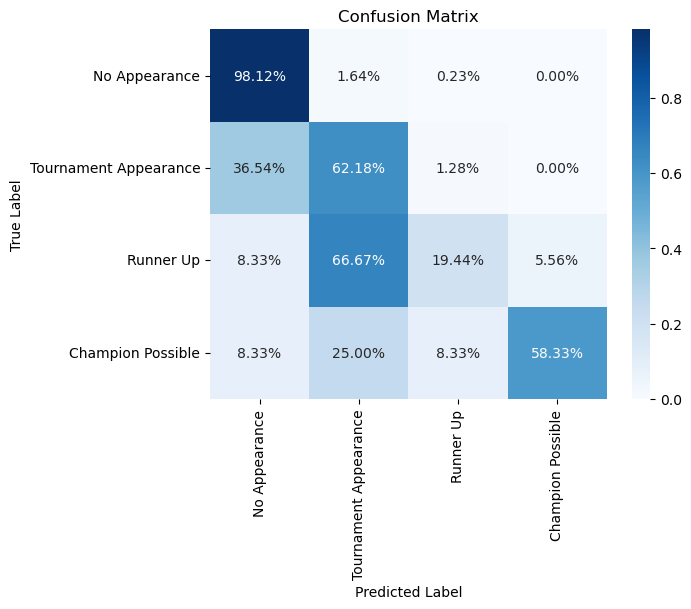

In [37]:
#Class-weighted Random Forest
rf = RandomForestClassifier(
    class_weight='balanced', 
    max_depth=None, 
    n_estimators=100, 
    random_state=42
)
rf.fit(X_train, y_train)

#Predictions and accuracy scores
y_pred = rf.predict(X_test)
test_accuracy = rf.score(X_test, y_test)
train_accuracy = rf.score(X_train, y_train) #check for overfitting
cv_scores = cross_val_score(rf, X_train, y_train, cv=5, scoring='accuracy')


#Print accuracy results
print("Training Accuracy:", train_accuracy)
print("Test Accuracy:", test_accuracy)
print("Cross-Validation Accuracy (mean):", cv_scores.mean())
print("Cross-Validation Accuracy (std):", cv_scores.std())

#Print Classification Report
report = classification_report(y_test, y_pred, target_names=label_encoder.classes_)
print("Classification Report:")
print(report)

#Custom order for confusion matrix labels for better visualization
custom_order = ['No Appearance', 'Tournament Appearance', 'Runner Up', 'Champion Possible']
cm = confusion_matrix(y_test, y_pred, labels=[label_encoder.transform([label])[0] for label in custom_order])

#Normalize the confusion matrix so that each value represents a percentage instead of the count of predictions
cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

#Plot the heatmap
sns.heatmap(cm_normalized, annot=True, fmt='.2%', cmap='Blues', xticklabels=custom_order, yticklabels=custom_order)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()


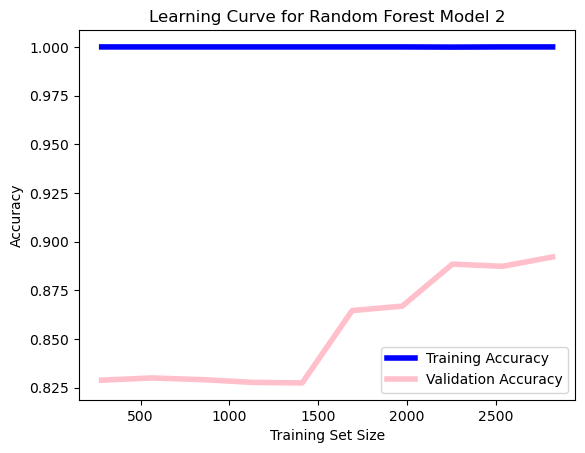

In [38]:
#Learning curve data
train_sizes, train_scores, test_scores = learning_curve(
    rf, X, y, cv=5, scoring='accuracy', train_sizes=np.linspace(0.1, 1.0, 10), random_state=42
)

#Calculate mean for training and testing scores
train_mean = np.mean(train_scores, axis=1)
test_mean = np.mean(test_scores, axis=1)

# lot the learning curve
plt.plot(train_sizes, train_mean, label='Training Accuracy', color='blue')
plt.plot(train_sizes, test_mean, label='Validation Accuracy', color='pink')
plt.title('Learning Curve for Random Forest Model 2')
#make the line thicker for presentation
plt.gca().get_lines()[0].set_linewidth(4)
plt.gca().get_lines()[1].set_linewidth(4)
plt.xlabel('Training Set Size')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

**Results**

The best parameters selected were max_depth=None with class_weight='balanced'. The confusion matrix remains like the baseline, with high accuracy on "No Appearance" and improved but still limited performance on minority classes.

The tuned Random Forest maintained perfect training accuracy (100%) and achieved a test accuracy of ~89.7% meaning that it is still overfitting.

The confusion matrix did show a slight improvement:
- `Champion Possible` accuracy improved slightly to 58.3%, up from 50%
- `Runner Up` remained difficult to classify accurately (19.4% recall), with most predictions defaulting to `Tournament Appearance`
- `Tournament Appearance` improved slightly to 62.2%, but still got confused with `No Appearance`

Even after parameter tuning, the model favors the most frequent classes. 

### **Model 3 SMOTE & Random Forest**

Due to the class imbalance, SMOTE (Synthetic Minority Oversampling Technique) was applied to oversample underrepresented classes before training a shallower Random Forest (max_depth=5) to reduce overfitting.

Training Accuracy: 0.8599246231155779
Test Accuracy: 0.8221381267738883
Cross-Validation Accuracy (mean): 0.8473618090452261
Cross-Validation Accuracy (std): 0.010785013081072714
Classification Report:
                       precision    recall  f1-score   support

    Champion Possible       0.73      0.67      0.70        12
        No Appearance       0.97      0.86      0.91       853
            Runner Up       0.37      0.69      0.48        36
Tournament Appearance       0.46      0.67      0.55       156

             accuracy                           0.82      1057
            macro avg       0.63      0.72      0.66      1057
         weighted avg       0.87      0.82      0.84      1057



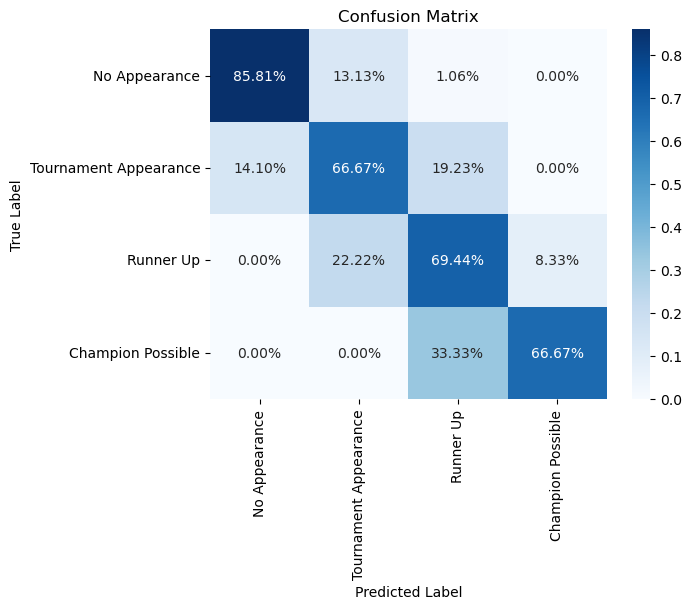

In [41]:
rf = RandomForestClassifier(
    max_depth=5,  # Reduced from None to limit overfitting
    class_weight='balanced_subsample',  # Class weights for imbalanced classes
    random_state=42
)

# oversample the minority classes 
smote = SMOTE(random_state=42)
X_train_resample, y_train_resample = smote.fit_resample(X_train, y_train)
rf.fit(X_train_resample, y_train_resample)

y_pred = rf.predict(X_test)
test_accuracy = rf.score(X_test, y_test)


#check for overfitting
train_accuracy = rf.score(X_train_resample, y_train_resample)

print("Training Accuracy:", train_accuracy)
print("Test Accuracy:", test_accuracy)

cv_scores = cross_val_score(rf, X_train_resample, y_train_resample, cv=5, scoring='accuracy')

print("Cross-Validation Accuracy (mean):", cv_scores.mean())
print("Cross-Validation Accuracy (std):", cv_scores.std())

#Print Classification Report
report = classification_report(y_test, y_pred, target_names=label_encoder.classes_)
print("Classification Report:")
print(report)

#Custom order for confusion matrix labels for better visualization
custom_order = ['No Appearance', 'Tournament Appearance', 'Runner Up', 'Champion Possible']
cm = confusion_matrix(y_test, y_pred, labels=[label_encoder.transform([label])[0] for label in custom_order])

#Normalize the confusion matrix so that each value represents a percentage instead of the count of predictions
cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

#Plot the heatmap
sns.heatmap(cm_normalized, annot=True, fmt='.2%', cmap='Blues', xticklabels=custom_order, yticklabels=custom_order)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()


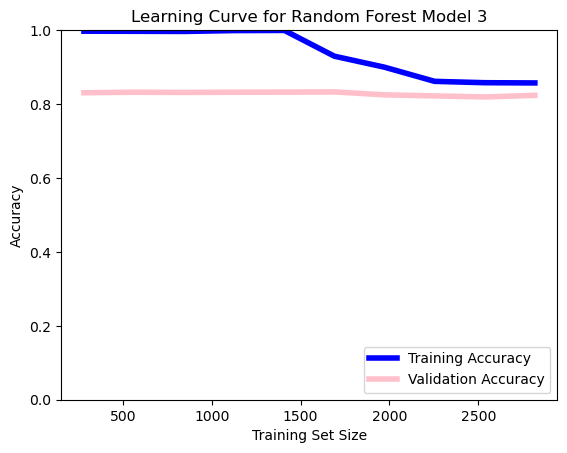

In [42]:
#Learning curve data
train_sizes, train_scores, test_scores = learning_curve(
    rf, X, y, cv=5, scoring='accuracy', train_sizes=np.linspace(0.1, 1.0, 10), random_state=42
)

#Calculate mean for training and testing scores
train_mean = np.mean(train_scores, axis=1)
test_mean = np.mean(test_scores, axis=1)

# lot the learning curve
plt.plot(train_sizes, train_mean, label='Training Accuracy', color='blue')
plt.plot(train_sizes, test_mean, label='Validation Accuracy', color='pink')
plt.title('Learning Curve for Random Forest Model 3')
#make the line thicker for presentation
plt.gca().get_lines()[0].set_linewidth(4)
plt.gca().get_lines()[1].set_linewidth(4)
plt.xlabel('Training Set Size')
plt.ylabel('Accuracy')
plt.ylim(0, 1)
plt.legend(loc='lower right')
plt.show()

**Results**

Training accuracy dropped to ~86%, and test accuracy to ~82%, but the model was more balanced across classes.

The confusion matrix showed significant improvements:
- `Runner Up` recall improved to 69% (from 19% in Model 2)
- `Champion Possible` recall increased to 67% (from 58%).

The performance of the majority class slightly decreased, but minority class predictions increased dramatically.

The macro F1-score improved, indicating better overall fairness across all classes.

Looking at the learning curve, the narrow gap between train/test accuracy shows that this model reduced overfitting while also improving minority class performance. Therefore, SMOTE was a good strategy for working with this imbalanced data for classification tasks.



### **Model 4 Decision Tree**

A single Decision Tree model was trained with SMOTE data and a max_depth of 4. The max depth was found by looking at a validation curve to balance bias and variance. Depth 4 was selected to help the model have high accuracy while avoiding becoming overfit.

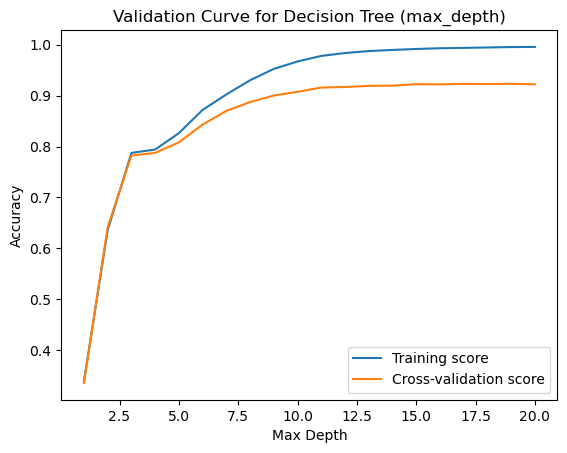

In [46]:

# Define range of max_depth values to test
param_range = np.arange(1, 21)

smote = SMOTE(random_state=42)
X_train_dt, y_train_dt = smote.fit_resample(X_train, y_train)
# Get training and validation scores
train_scores, test_scores = validation_curve(
    DecisionTreeClassifier(criterion='gini', min_samples_split=4, splitter='best', random_state=42),
    X_train_dt, y_train_dt,
    param_name="max_depth",
    param_range=param_range,
    cv=5,
    scoring="f1_macro",
)

# Calculate mean and std
train_mean = np.mean(train_scores, axis=1)
test_mean = np.mean(test_scores, axis=1)
train_std = np.std(train_scores, axis=1)
test_std = np.std(test_scores, axis=1)

# Plot
plt.plot(param_range, train_mean, label="Training score")
plt.plot(param_range, test_mean, label="Cross-validation score")
plt.xlabel("Max Depth")
plt.ylabel("Accuracy")
plt.title("Validation Curve for Decision Tree (max_depth)")
plt.legend(loc="lower right")
plt.show()


Training Accuracy: 0.7910804020100503
Test Accuracy: 0.8107852412488175
Cross-Validation Accuracy (mean): 0.7837939698492462
Cross-Validation Accuracy (std): 0.014495767296469552
Classification Report:
                       precision    recall  f1-score   support

    Champion Possible       0.67      0.67      0.67        12
        No Appearance       0.97      0.85      0.91       853
            Runner Up       0.35      0.72      0.47        36
Tournament Appearance       0.44      0.62      0.51       156

             accuracy                           0.81      1057
            macro avg       0.61      0.72      0.64      1057
         weighted avg       0.87      0.81      0.83      1057



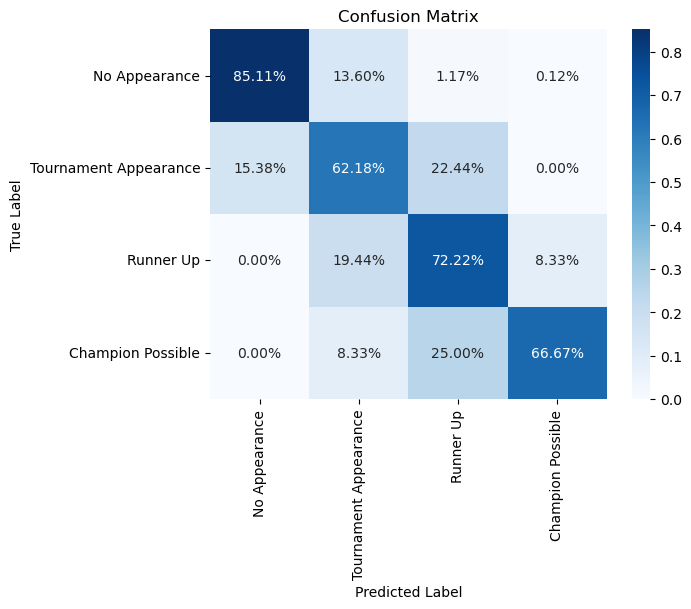

In [47]:
dt = DecisionTreeClassifier(
    criterion='gini', #entropy or gini
    min_samples_split=4, #minimum number of samples required to split an internal node
    splitter='best',
    max_depth=4, #this is the best depth i got   
    random_state=42
)

dt.fit(X_train_dt, y_train_dt)

y_pred_dt = dt.predict(X_test)
train_accuracy_dt = dt.score(X_train_dt, y_train_dt)
test_accuracy_dt = dt.score(X_test, y_test)
cv_scores_dt = cross_val_score(dt, X_train_dt, y_train_dt, cv=5, scoring='accuracy')

#Print accuracy results
print("Training Accuracy:", train_accuracy_dt)
print("Test Accuracy:", test_accuracy_dt)
print("Cross-Validation Accuracy (mean):", cv_scores_dt.mean())
print("Cross-Validation Accuracy (std):", cv_scores_dt.std())

report = classification_report(y_test, y_pred_dt, target_names=label_encoder.classes_)
print("Classification Report:")
print(report)

custom_order = ['No Appearance', 'Tournament Appearance', 'Runner Up', 'Champion Possible']

# Generate the confusion matrix with the custom label order
cm = confusion_matrix(y_test, y_pred_dt, labels=[label_encoder.transform([label])[0] for label in custom_order])

# Normalize the confusion matrix
cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

# Plot the heatmap with the custom label order
sns.heatmap(cm_normalized, annot=True, fmt='.2%', cmap='Blues', xticklabels=custom_order, yticklabels=custom_order)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

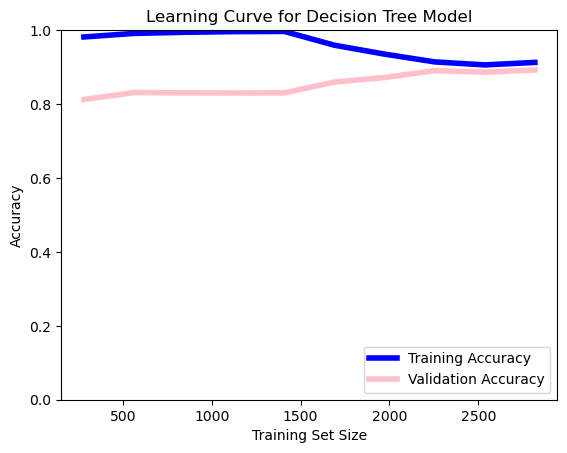

In [48]:
#Learning curve data
train_sizes, train_scores, test_scores = learning_curve(
    dt, X, y, cv=5, scoring='accuracy', train_sizes=np.linspace(0.1, 1.0, 10), random_state=42
)

#Calculate mean for training and testing scores
train_mean = np.mean(train_scores, axis=1)
test_mean = np.mean(test_scores, axis=1)

#Plot the learning curve
plt.plot(train_sizes, train_mean, label='Training Accuracy', color='blue')
plt.plot(train_sizes, test_mean, label='Validation Accuracy', color='pink')
plt.title('Learning Curve for Decision Tree Model')
#make the line thicker for presentation
plt.gca().get_lines()[0].set_linewidth(4)
plt.gca().get_lines()[1].set_linewidth(4)
plt.xlabel('Training Set Size')
plt.ylabel('Accuracy')
plt.ylim(0, 1)
plt.legend(loc='lower right')
plt.show()

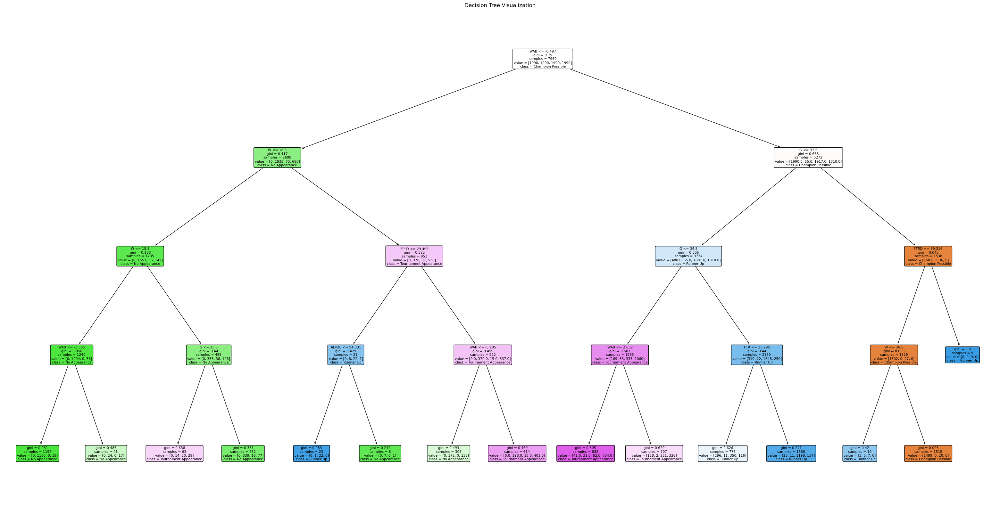

In [49]:
plt.figure(figsize=(40, 20))
plot_tree(dt, feature_names=X.columns, class_names=label_encoder.classes_, filled=True, rounded=True)
plt.title("Decision Tree Visualization")
plt.show()

**Decision Tree Visualization**

The plot of the decision tree shows the full structure of the trained Decision Tree model. Each node represents a decision split based on a feature threshold, with the most important features (WAB, G, and W) appearing closer to the top. The colored nodes are the predicted class labels, with the darkness of the shade reflecting higher class purity (confidence). Leaf nodes show the final classification outcome for teams following that decision path.

In [25]:
#which features are most important
feature_importances = pd.DataFrame(dt.feature_importances_, index=X.columns, columns=["Importance"]).sort_values("Importance", ascending=False)
feature_importances.head(len(feature_importances))

,Importance
G,0.457873
WAB,0.394262
W,0.092320
FTR,0.041881
3P_D,0.006459
FTRD,0.004626
ADJDE,0.002579
ADJOE,0.000000
EFG_O,0.000000
EFG_D,0.000000


**Results** 

Test accuracy reached ~81%, with training accuracy at ~79%, as it improved generalization over previous models. Model 4 also reduced overfitting as there was a very narrow gap in the learning curve plot.


Looking at the confusion matrix:
- Improvement for `Runner Up` (recall = 72%) 
- Consistent performance for `Champion Possible` (recall = 67%)
- `Tournament Appearance` predictions remained okay as it still gets mixed with `No Appearance`

The decision tree visualization used WAB, G, and W as the most important features driving classification.

While this model is slightly less accurate than the tuned Random Forest, it provides high interpretability and better balanced class performance, making it a better choice for explaining postseason outcomes.

### **KMeans**

2


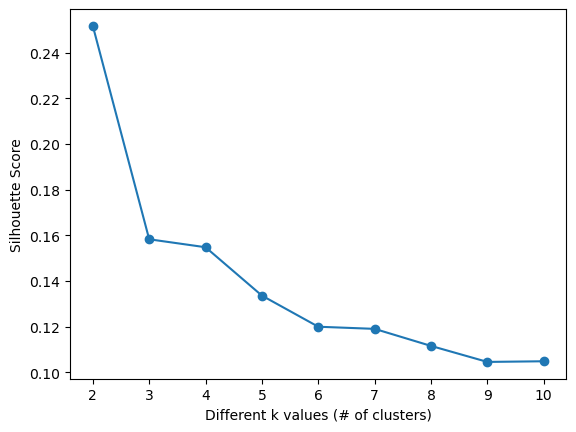

In [26]:
#Using silhouette score to find best K
X = basketball_df.select_dtypes(include='number')
silhouette_scores = []
k_range = range(2,11)

for k in k_range:
    kmeans = KMeans(n_clusters=k, n_init='auto')
    labels = kmeans.fit_predict(X)
    score = silhouette_score(X, labels)
    silhouette_scores.append((k, score))

best_k, best_score = max(silhouette_scores, key=lambda x: x[1])
print(best_k)

plt.plot([k for k, _ in silhouette_scores], [s for _, s in silhouette_scores], marker='o')
plt.xlabel('Different k values (# of clusters)')
plt.ylabel('Silhouette Score')
plt.show()

## **Reflection Questions:**

1. Are the results statistically significant? 

- Looking at the accuracy metrics, there is a cross-validation accuracy of about 86%, with a test accuracy of about 83%. The Macro F1 Score is 65% and the Weighted F1 Score is 84%. Using these metrics, it can be concluded that the model is performing well across multiple splits. Additionally, the precision and recall scores are non-trivial for the minority classes, and the confusion matrix shows pretty good separation in predictions. With this in mind, it can be concluded that the results are statistically significant, and that the model learns a real pattern from the season statistics instead of just memorizing data. 

2. Did you prove or disprove your hypothesis? 

- Based off of the results, the model can predict groupings with about 83% test accuracy, the F1 score is 0.64 for the minority class and higher for other classes, and the confusion matrix shows viable predictions for classes and even inevitable miscalculations for other classes. Therefore, we can disprove our hypothesis, and conclude that season statistics can be used ot predict tournament groupings. 

3. How could you improve your analysis? 
- The class imbalance could have been addressed more dirctly. For example, classes like "Champion Possible" had only 12 samples, but other classes had over 800 samples. 
Additionally, further feature engineering could have been done to create "interaction features" like win/seed, or win rate, or ADJOE - ADJDE. 
Further models like Logistic Regression could have also been used for comparison models to see which model was better at the classification problem. 

4. A couple lessons learned from this is that the problem we are trying to solve should be thought through more precisely prior to choosing our datasets. We had to change our topic a couple times because the problem we were trying to solve either didn't have enough data for it, or we simply couldn't access any data for it. 